# #Output label
  #'01':'neutral',
  #'02':'calm',
  #'03':'happy',
  #'04':'sad',
  #'05':'angry',
  #'06':'fearful',
  #'07':'disgust',
  #'08':'surprised'

In [10]:
#Install all the Reqiuired Libraries and Packages 
import os
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc , logfbank
import librosa as lr
import os, glob, pickle
import librosa
from scipy import signal
import noisereduce as nr
from glob import glob
import librosa
get_ipython().magic('matplotlib inline')
#All the Required Packages and Libraies are installed.
import soundfile
from tensorflow.keras.layers import Conv2D,MaxPool2D, Flatten, LSTM
from keras.layers import Dropout,Dense,TimeDistributed
from keras.models import Sequential
from tensorflow.keras.utils import to_categorical 
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\requests\__init__.py:104: RequestsDependencyWarning: urllib3 (1.26.14) or chardet (5.0.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  RequestsDependencyWarning)


In [13]:
#Loading the required RAVDESS DataSet with length of 1439 Audio Files 
os.listdir(path='.\speech-emotion-recognition-ravdess-data')
def getListOfFiles(dirName):
    listOfFile=os.listdir(dirName)
    allFiles=list()
    for entry in listOfFile:
        fullPath=os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles=allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

dirName = './speech-emotion-recognition-ravdess-data'
listOfFiles = getListOfFiles(dirName)
len(listOfFiles)

1439

In [21]:
#Use the Speech-Recognition API to get the Raw Text from Audio Files, Though Speech Recognition
#is less strong for large chunk of files , so used Error Handling , where when it is not be able to 
#produce the text of a particular Audio File it prints the statement 'error'.Just for understanding Audio
import speech_recognition as sr
r=sr.Recognizer()
for file in range(0 , len(listOfFiles) , 1):
    with sr.AudioFile(listOfFiles[file]) as source:
        audio = r.listen(source)
        try:
            text = r.recognize_google(audio)
            print(text)
        except:
            print('error')

result2:
{   'alternative': [   {   'confidence': 0.86018962,
                           'transcript': 'could you talking by the door'},
                       {'transcript': 'did you talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'could you talk me by the door'},
                       {'transcript': 'could you talk in by the door'}],
    'final': True}
could you talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88211298,
                           'transcript': 'dog sitting by the door'},
                       {'transcript': 'dogs you sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'sitting by the door'}],
    'final': True}
dog sitting by the door
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'},

result2:
{   'alternative': [   {   'confidence': 0.86203146,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'kids or talking by the door'},
                       {'transcript': 'kids talking by the door'}],
    'final': True}
kids are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86824054,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs or sitting by the door'},
                       {'transcript': 'dogs sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.86350423,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs or sitting by the door'},
                       {'transcript': 'dogs sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   { 

result2:
{   'alternative': [   {   'confidence': 0.84853911,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'tags are sitting by the door'},
                       {'transcript': 'dogs are sitting by the tour'},
                       {'transcript': 'tags are sitting by the tour'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.84949201,
                           'transcript': 'tags are sitting by the door'},
                       {'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'tags are sitting by the tour'},
                       {'transcript': 'dogs are sitting by the tour'}],
    'final': True}
tags are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.87159091,
                           'transcript': "it's a talking by the door"},
                       {'transcript': 'hits are talking by the door'},

result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.81828499,
                           'transcript': 'talking by the dollar'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'are talking by the dollar'},
                       {'transcript': 'talking about the dollar'},
                       {'transcript': 'talking about dollar'}],
    'final': True}
talking by the dollar
result2:
{   'alternative': [   {   'confidence': 0.86236256,
                           'transcript': 'dogs are steering by the door'},
                       {'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'talks are steering by the door'}],
    'final': True}
dogs are steering by the door
resu

result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'sitting by the door'},
                       {'transcript': 'sit sitting by the door'},
                       {'transcript': 'sitting door'},
                       {'transcript': 'sitting by ther'}],
    'final': True}
sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
      

result2:
{   'alternative': [   {   'confidence': 0.87670022,
                           'transcript': 'sitting by the door'},
                       {'transcript': 'are sitting by the door'},
                       {'transcript': 'talk sitting by the door'},
                       {'transcript': 'door'}],
    'final': True}
sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.86800569,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs are sitting by the tour'},
                       {'transcript': 'talks are sitting by the door'},
                       {'transcript': 'talks are sitting by the tour'},
                       {'transcript': 'dogs sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.84376341,
                           'transcript': 'talking by the door'},
                       {'transcript': 'he that Hawking by t

result2:
{   'alternative': [   {   'confidence': 0.86409891,
                           'transcript': 'talking by the door'},
                       {'transcript': 'she to talking by the door'},
                       {'transcript': 'she tolking by the door'},
                       {'transcript': 'the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86508846,
                           'transcript': 'talks are sitting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'talks sitting by the door'}],
    'final': True}
talks are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.87857133,
                           'transcript': 'talk just sitting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'talk sitting by the door'},
                       {'transcript': 'sit sitting by the door'}

result2:
{   'alternative': [   {   'confidence': 0.81161952,
                           'transcript': 'kids are talking but the door'},
                       {'transcript': 'kids are talking but the'},
                       {'transcript': "kids are talking but don't"},
                       {'transcript': 'kids talking'},
                       {'transcript': 'kids are talking'}],
    'final': True}
kids are talking but the door
result2:
{   'alternative': [   {   'confidence': 0.84436381,
                           'transcript': 'dogs are sitting Barbie doll'},
                       {'transcript': 'darks are sitting Barbie doll'},
                       {'transcript': 'dogs are sitting'},
                       {'transcript': 'darks are sitting'},
                       {'transcript': 'dogs sitting Barbie doll'}],
    'final': True}
dogs are sitting Barbie doll
result2:
{   'alternative': [   {   'confidence': 0.87883621,
                           'transcript': 'dogs are sitting

result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.85167766,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'Kids Art Hawking by the door'},
                       {'transcript': 'kids are talking by the to'},
                       {'transcript': 'kids are talking by the tol'},
                       {'transcript': 'kids are talking by the told'}],
    'final': True}
kids are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86029607,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'kids or talking by the door'},
                       {'transcript': 'kids talking by the door'},
                       {'transcript': 'kids by the door'}],
    'final': True}
kids are talking by the door
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.88336068,
                   

result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'},
                       {'transcript': 'by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.87740821,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'dogs or sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.85488522,
                           'transcript': 'doctor sitting by the door'},
                       {'transcript': 'talk or sitting by the door'},
                       {'transcript': 'talk to sitting by the door'}],
    'final': True}
doctor sitting by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.88687533,
  

result2:
{   'alternative': [   {   'confidence': 0.87928486,
                           'transcript': 'talk with steering by the door'},
                       {'transcript': 'talk with searing by the door'},
                       {'transcript': 'door'},
                       {'transcript': 'talk with door'}],
    'final': True}
talk with steering by the door
result2:
{   'alternative': [   {   'confidence': 0.81151372,
                           'transcript': 'talking by the door'},
                       {'transcript': 'he to talking by the door'},
                       {'transcript': 'by the door'},
                       {'transcript': 'the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.8247658,
                           'transcript': 'heater talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
heater talking by the door
result2:
{   'alternative': [   {   'confidence': 0.8

result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'doctor sharing by the door'},
                       {'transcript': 'sharing by the door'}],
    'final': True}
doctor sharing by the door
result2:
{   'alternative': [   {   'confidence': 0.7843942,
                           'transcript': 'talking by the door'},
                       {'transcript': 'fucking by the door'},
                       {'transcript': 'why the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86136311,
                           'transcript': 'hey there talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
hey there talking by the door
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.84334707,
                           'transcript': 'talk to sitting by the door'},
                       {'transcript': 'sitting by the door'},
          

result2:
[]
error
result2:
{   'alternative': [   {'confidence': 0.72372955, 'transcript': 'by the door'},
                       {'transcript': 'the answer'},
                       {'transcript': 'the answer in by the door'},
                       {'transcript': 'to answer him by the door'}],
    'final': True}
by the door
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.86978036,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'did you talk in by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
did you talking by the door
result2:
{   'alternative': [   {   'confidence': 0.82370341,
                           'transcript': 'did you talk in by the door'},
                       {'transcript': 'did you talking by the door'},
                       {'transcript': 'did you talk in by the tour'},
                       {'transcript': 'did you talking by the to

result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.78855824,
                           'transcript': "God's sitting by the door"},
                       {'transcript': 'steering by the door'},
                       {'transcript': 'godding by the door'}],
    'final': True}
God's sitting by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.8246814,
                           'transcript': 'did you talking but to'},
                       {'transcript': 'could you talking but to'},
                       {'transcript': 'did you talking but door'},
                       {'transcript': 'could you talking but door'},
                       {'transcript': 'did you talking but tol'}],
    'final': True}
did you talking but to
result2:
{   'alternative': [   {   'confidence': 0.74303097,
                           'tra

result2:
{   'alternative': [   {   'confidence': 0.88271922,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'did talking by the door'}],
    'final': True}
did you talking by the door
result2:
{   'alternative': [   {   'confidence': 0.77733445,
                           'transcript': 'talk is selling by the door'},
                       {'transcript': 'talk to him by the door'},
                       {'transcript': 'ring by the door'}],
    'final': True}
talk is selling by the door
result2:
{   'alternative': [   {   'confidence': 0.87709522,
                           'transcript': "don't you sitting by the door"},
                       {'transcript': "don't sitting by the door"},
                       {'transcript': 'sitting by the door'}],
    'final': True}
don't you sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
  

result2:
{   'alternative': [   {   'confidence': 0.83431494,
                           'transcript': 'glycerine by the tour'},
                       {'transcript': 'visiting by the tour'},
                       {'transcript': 'restoring by the tour'}],
    'final': True}
glycerine by the tour
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'},
                       {'transcript': 'by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'kids talking by the door'}],
    'final': True}
kids are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86342031,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'t

result2:
{   'alternative': [   {   'confidence': 0.77726597,
                           'transcript': 'talk to sitting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'talk to sitting'},
                       {'transcript': 'talk to sitting door'}],
    'final': True}
talk to sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'kids talking by the door'}],
    'final': True}
kids are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'kids are talking by the door'},
                       {'transcript': 'kids talking by the door'}],
    'final': True}
kids are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.8660329,
                           'transcript': 'dogs are sitting by the doo

result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.87962323,
                           'transcript': 'talk to selling by the door'},
                       {'transcript': 'talk to sing by the door'},
                       {'transcript': 'sing by the door'},
                       {'transcript': 'talk to seeing by the door'}],
    'final': True}
talk to selling by the door
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.83538228,
                           'transcript': 'dogs sitting by the door'},
                       {'transcript': 'dog sitting by the door'},
                       {'transcript': 'dogs are sitting by the door'}],
    'final': True}
dogs sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88011235,
                           'transcript': 'dogs sitting by the door'},
                       {'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dog sitting 

result2:
{   'alternative': [   {   'confidence': 0.88362694,
                           'transcript': 'talking by the door'},
                       {'transcript': 'by the door'},
                       {'transcript': 'the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.8479284,
                           'transcript': 'talking by the door'},
                       {'transcript': "you don't talking by the door"},
                       {'transcript': 'you talking by the door'},
                       {'transcript': "you don't talk anymore"}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.73390591,
                           'transcript': 'ring by the door'},
                       {'transcript': 'talks is selling by the door'},
                       {'transcript': 'the door'}],
    'final': True}
ring by the door
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.860883

result2:
{   'alternative': [   {   'confidence': 0.80692893,
                           'transcript': 'can you talking by the door'},
                       {'transcript': 'get you talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
can you talking by the door
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.73889732,
                           'transcript': 'dogs sitting by the door'},
                       {'transcript': 'dogs saying by the door'},
                       {'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dog'}],
    'final': True}
dogs sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.82480955,
                           'transcript': 'can you talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'can you talk in by the door'},
                       {'transcript': 'b

result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'doctor sitting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'door'}],
    'final': True}
doctor sitting by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.78955364,
                           'transcript': 'doctor sitting by the door'},
                       {'transcript': 'talk sitting by the door'},
                       {'transcript': 'talk to sitting by the door'}],
    'final': True}
doctor sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.85212356,
                           'transcript': 'dog receiving by the door'},
                       {'transcript': 'dog sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript'

result2:
{   'alternative': [   {   'confidence': 0.73085892,
                           'transcript': 'talking by the door'},
                       {'transcript': 'talking'}],
    'final': True}
talking by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.83421868,
                           'transcript': 'hey the talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'hey that talking by the door'}],
    'final': True}
hey the talking by the door
result2:
{   'alternative': [   {   'confidence': 0.87675393,
                           'transcript': 'talking by the door'},
                       {'transcript': 'the door'}],
    'final': True}
talking by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {

result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88101751,
                           'transcript': 'get the talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'get talking by the door'}],
    'final': True}
get the talking by the door
result2:
{   'alternative': [   {   'confidence': 0.85175627,
                           'transcript': 'doctor setting by the door'},
                       {'transcript': 'doctor sitting by the door'},
                       {'transcript': 'doctors setting by the door'},
                       {'transcript': 'doctors sitting by the door'},
                       {'transcript': 'talk to setting by the door'}],
    'final': True}
doctor setting by the door
result2:
{   'alternative': [   {   'confidence': 0.84863979,


result2:
{   'alternative': [   {   'confidence': 0.87251252,
                           'transcript': 'doctor string by the door'},
                       {'transcript': 'Doctor Strange by the door'},
                       {'transcript': 'jog Singh by the door'},
                       {'transcript': 'doctoring by the door'}],
    'final': True}
doctor string by the door
result2:
{   'alternative': [   {   'confidence': 0.79134768,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'setting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88432187,
                           'transcript': 'gether talking by the door'},
                       {'transcript': 'get talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
gether talking by the door
r

result2:
{   'alternative': [   {   'confidence': 0.84492576,
                           'transcript': 'did you talk in by the door'},
                       {'transcript': 'did you talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
did you talk in by the door
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.87137175,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs or sitting by the door'},
                       {'transcript': 'dogs sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.73274964,
                           'transcript': 'talk just sitting by the door'},
                       {'transcript': 'talk just said in by the door'},
                       {'transcript': 'talk just said by the door'}],
    'final': True}
talk just s

result2:
{   'alternative': [   {   'confidence': 0.85008544,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'did you talk in by the door'},
                       {'transcript': 'did talking by the door'},
                       {'transcript': 'did you talk by the door'}],
    'final': True}
did you talking by the door
result2:
{   'alternative': [   {   'confidence': 0.87488729,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'talks are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'dog sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.87537766,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dog sitting by the door'},
                      

result2:
{   'alternative': [   {   'confidence': 0.80968857,
                           'transcript': 'sitting by the door'},
                       {'transcript': 'talk to sitting by the door'},
                       {'transcript': 'talk sitting by the door'}],
    'final': True}
sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.85966778,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'dogs sitting by the door'},
                       {'transcript': 'sitting by the door'}],
    'final': True}
dogs are sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.84132516,
                           'transcript': 'kids talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
kids talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86273569,
                           'transcript': 'talking by the door'},
                

result2:
{   'alternative': [   {   'confidence': 0.87729234,
                           'transcript': 'sitting by the door'},
                       {'transcript': 'the door'}],
    'final': True}
sitting by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.7303499,
                           'transcript': 'talking by the door'},
                       {'transcript': 'Talking Tom'}],
    'final': True}
talking by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.8778758,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'did you talk talking by the door'},
                       {'transcript': 'did talking by the door'}],
    'final': True}
did you talking by the door
result2:
{   'alternative': [   {   'confidence': 0

result2:
{   'alternative': [   {   'confidence': 0.85372621,
                           'transcript': 'talk to sitting by the door'},
                       {'transcript': 'talk you sitting by the door'},
                       {'transcript': 'talks you sitting by the door'},
                       {'transcript': 'talk to you sitting by the door'}],
    'final': True}
talk to sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.8597849,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'could you talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
did you talking by the door
result2:
{   'alternative': [   {   'confidence': 0.85886985,
                           'transcript': 'did you talking by the door'},
                       {'transcript': 'could you talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': T

result2:
{   'alternative': [   {   'confidence': 0.86001682,
                           'transcript': 'change the talking by the door'},
                       {'transcript': 'change talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
change the talking by the door
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'hips are talking by the door'},
                       {'transcript': 'are talking by the door'}],
    'final': True}
hips are talking by the door
result2:
{   'alternative': [   {   'confidence': 0.85644913,
                           'transcript': '6 are talking by the door'},
                       {'transcript': '6 talking by the door'},
                       {'transcript': 'are talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
6 are talking by the door
result2:
[]
error
resu

result2:
{   'alternative': [   {   'confidence': 0.82724112,
                           'transcript': 'setting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'by the door'}],
    'final': True}
setting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'},
                       {'transcript': 'by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687539,
                           'transcript': 'talking by the door'},
                       {'transcript': 'by the door'}],
    'final': True}
talking by the door
result2:
{   'alternative': [   {   'confidence': 0.83543062,
                           'transcript': 'talk to setting by the door'},
                       {'transcript': 'talk you sitting by the door'},
                       {'transcript': 'talk to you sitting by the doo

result2:
{   'alternative': [   {   'confidence': 0.82880133,
                           'transcript': 'change to talking by the door'},
                       {'transcript': 'say to talking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'change to talking by the tour'},
                       {'transcript': 'change talking by the door'}],
    'final': True}
change to talking by the door
result2:
{   'alternative': [   {   'confidence': 0.84426945,
                           'transcript': 'talk to sitting for the door'},
                       {'transcript': 'talk to sitting for the tour'},
                       {'transcript': 'talk to sitting'},
                       {'transcript': 'talk you sitting for the door'},
                       {'transcript': 'talk you sitting for the tour'}],
    'final': True}
talk to sitting for the door
result2:
{   'alternative': [   {   'confidence': 0.79068911,
                     

result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'talks are sitting by the door'}],
    'final': True}
talks are sitting by the door
result2:
[]
error
result2:
[]
error
result2:
[]
error
result2:
{   'alternative': [   {   'confidence': 0.85111582,
                           'transcript': 'doctor sitting by the door'},
                       {'transcript': 'joggers sitting by the door'},
                       {'transcript': 'jogger sitting by the door'},
                       {'transcript': 'sitting by the door'}],
    'final': True}
doctor sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.845339,
                           'transcript': 'dogs are sitting by the door'},
                       {'transcript': 'talks are sitting by the door'},
                       {'transcript': 'dogs are setting by the door'},
                       {'transcript': 'talks are setting by the door'}],
    'final': True}
dogs are

result2:
{   'alternative': [   {   'confidence': 0.87208575,
                           'transcript': 'khejar talking by the door'},
                       {'transcript': 'GetJar talking by the door'}],
    'final': True}
khejar talking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'khejar talking by the door'},
                       {'transcript': 'talking by the door'}],
    'final': True}
khejar talking by the door
result2:
{   'alternative': [   {   'confidence': 0.84851772,
                           'transcript': 'setting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'by the door'},
                       {'transcript': 'talk you sitting by the door'}],
    'final': True}
setting by the door
result2:
{   'alternative': [   {   'confidence': 0.84718037,
                           'transcript': 'doctor sitting by the door'},
                   

result2:
{   'alternative': [   {   'confidence': 0.85309952,
                           'transcript': 'talk to sitting by the door'},
                       {'transcript': 'talk you sitting by the door'},
                       {'transcript': 'talk to sitting by the tour'},
                       {'transcript': 'talk you sitting by the tour'},
                       {'transcript': 'sitting by the door'}],
    'final': True}
talk to sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': 'Khetri talking by the door'},
                       {'transcript': 'khetriking by the door'}],
    'final': True}
Khetri talking by the door
result2:
{   'alternative': [   {   'confidence': 0.81148338,
                           'transcript': 'get the talking by the tour'},
                       {'transcript': 'get the talking by the door'},
                       {'transcript': 'did you talking by the tour'},
                      

result2:
{   'alternative': [   {   'confidence': 0.87158144,
                           'transcript': 'torture sitting by the door'},
                       {'transcript': 'tortoise or sitting by the door'},
                       {'transcript': 'tortoise sitting by the door'},
                       {'transcript': 'sitting by the door'},
                       {'transcript': 'torture sitting by the'}],
    'final': True}
torture sitting by the door
result2:
{   'alternative': [   {   'confidence': 0.8749733,
                           'transcript': 'kids talking by the door'},
                       {'transcript': 'he said talking by the door'},
                       {'transcript': 'he said Hawking by the door'},
                       {'transcript': 'talking by the door'},
                       {'transcript': 'kids talking'}],
    'final': True}
kids talking by the door
result2:
{   'alternative': [   {   'confidence': 0.8666746,
                           'transcript': 'Hawking b

result2:
{   'alternative': [   {   'confidence': 0.84823275,
                           'transcript': 'she is Hawking by the door'},
                       {'transcript': 'she said Hawking by the door'},
                       {'transcript': 'she said talking by the door'},
                       {'transcript': 'she is it Hawking by the door'}],
    'final': True}
she is Hawking by the door
result2:
{   'alternative': [   {   'confidence': 0.88687533,
                           'transcript': "it's not talking by the door"},
                       {'transcript': "it's not talking by the toy"}],
    'final': True}
it's not talking by the door
result2:
{   'alternative': [   {   'confidence': 0.86357009,
                           'transcript': 'thoughts sitting by the door'},
                       {'transcript': 'talk to sitting by the door'},
                       {'transcript': 'thought sitting by the door'},
                       {'transcript': 'thoughts is sitting by the door'}],

In [22]:
#Now Cleaning Step is Performed where:
#DOWN SAMPLING OF AUDIO FILES IS DONE  AND PUT MASK OVER IT AND DIRECT INTO CLEAN FOLDER
#MASK IS TO REMOVE UNNECESSARY EMPTY VOIVES AROUND THE MAIN AUDIO VOICE 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

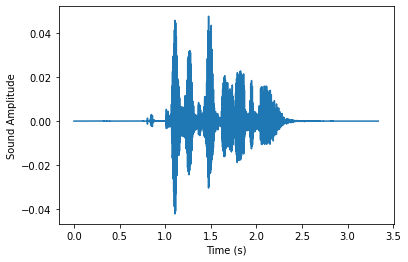

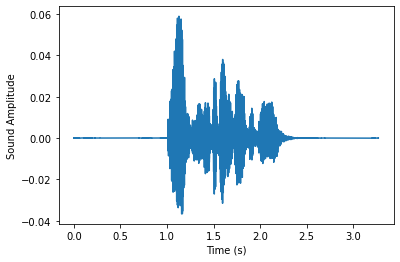

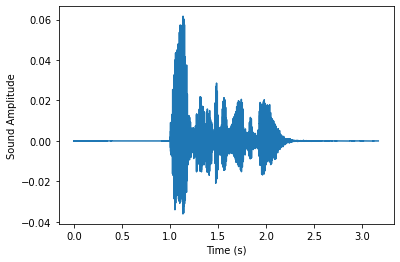

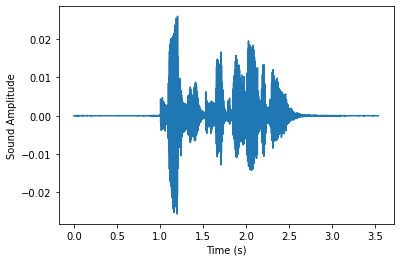

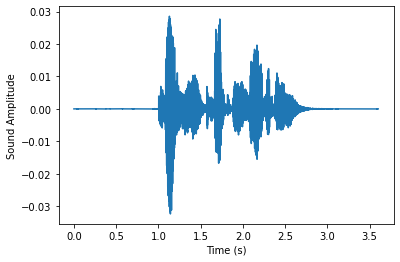

...

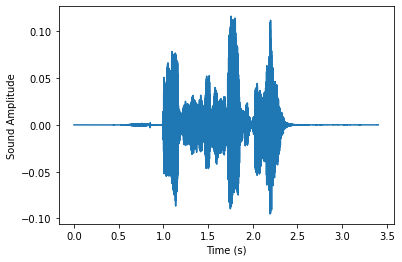

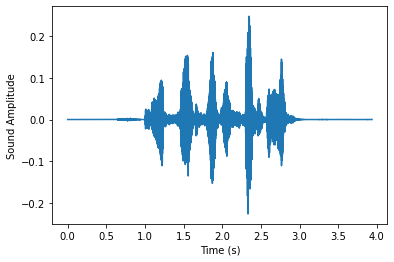

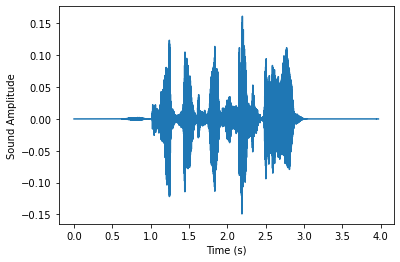

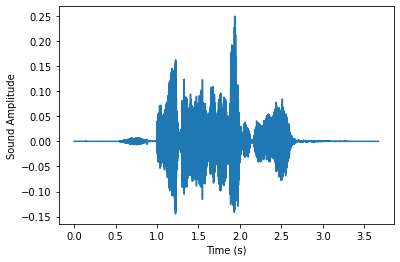

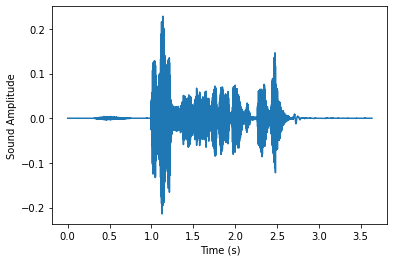

AttributeError: 'numpy.ndarray' object has no attribute 'spectrogram'

In [23]:
#Plotting the Basic Graphs for understanding of Audio Files :
for file in range(0 , len(listOfFiles) , 1):
    audio , sfreq = lr.load(listOfFiles[file])
    time = np.arange(0 , len(audio)) / sfreq
    
    fig ,ax = plt.subplots()
    ax.plot(time , audio)
    ax.set(xlabel = 'Time (s)' , ylabel = 'Sound Amplitude')
    plt.show()
    
#PLOT THE SEPCTOGRAM
for file in range(0 , len(listOfFiles) , 1):
     sample_rate , samples = wavfile.read(listOfFiles[file])
     frequencies , times, spectrogram = signal.spectrogram(samples, sample_rate) 
     plt.pcolormesh(times, frequencies, spectrogram)
     plt.imshow(spectrogram)
     plt.ylabel('Frequency [Hz]')
     plt.xlabel('Time [sec]')
     plt.show()

In [24]:
#Next Step is In-Depth Visualisation of Audio Fiels and its certain features to plot for.
#They are the Plotting Functions to be called later. 
def plot_signals(signals):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Time Series' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(signals.keys())[i])
            axes[x,y].plot(list(signals.values())[i])
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def plot_fft(fft):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Fourier Transform' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            data = list(fft.values())[i]
            Y,freq = data[0] , data[1]
            axes[x,y].set_title(list(fft.keys())[i])
            axes[x,y].plot(freq , Y)
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
    
def plot_fbank(fbank):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Filter Bank Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(fbank.keys())[i])
            axes[x,y].imshow(list(fbank.values())[i],cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
            
def plot_mfccs(mfccs):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Mel Frequency Capstrum  Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(mfccs.keys())[i])
            axes[x,y].imshow(list(mfccs.values())[i],
                             cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def calc_fft(y,rate):
    n = len(y)
    freq = np.fft.rfftfreq(n , d= 1/rate)
    Y= abs(np.fft.rfft(y)/n)
    return(Y,freq)

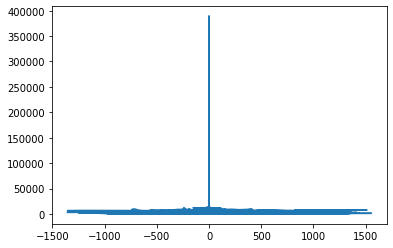

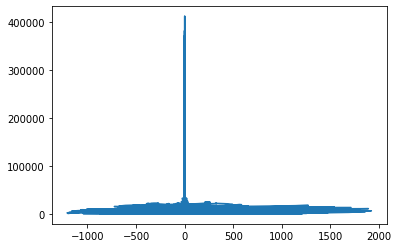

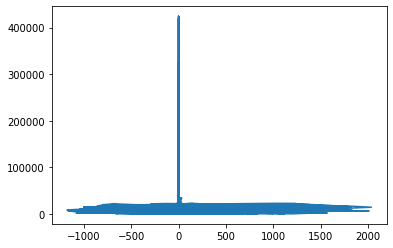

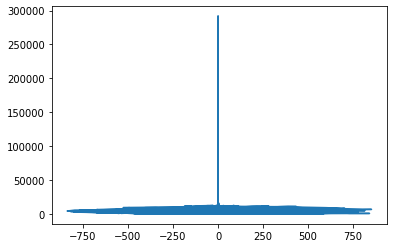

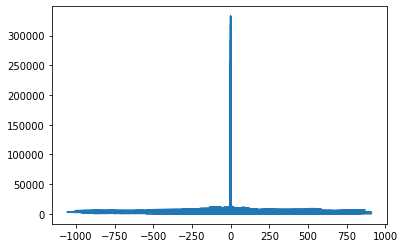

...

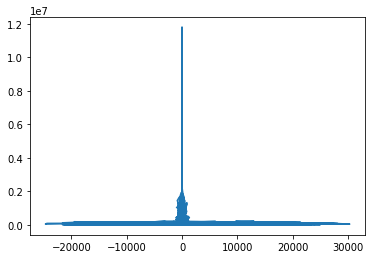

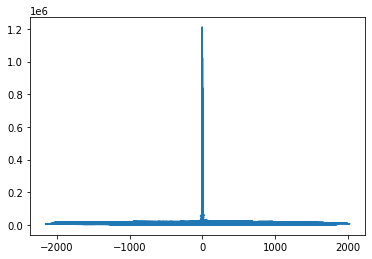

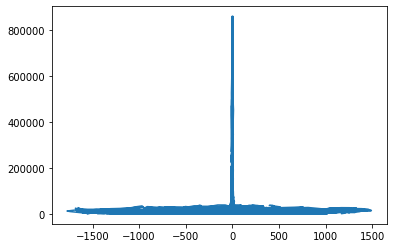

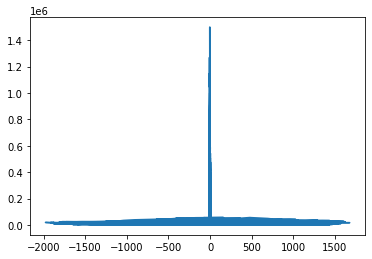

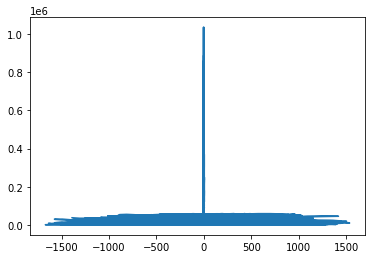

In [25]:
# Here The Data Set is loaded and plots are Visualised by Calling the Plotting Functions . 
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from scipy.fftpack import fft
import numpy as np
for file in range(0 , len(listOfFiles) , 1):
    rate, data = wav.read(listOfFiles[file])
    fft_out = fft(data)
    %matplotlib inline
    plt.plot(data, np.abs(fft_out))
    plt.show()
    
signals={}
fft={}
fbank={}
mfccs={}
# load data
for file in range(0 , len(listOfFiles) , 1):
#     rate, data = wavfile.read(listOfFiles[file])
     signal,rate =librosa.load(listOfFiles[file] , sr=44100)
     mask = envelope(signal , rate , 0.0005)
     signals[file] = signal
     fft[file] = calc_fft(signal , rate)
    
     bank = logfbank(signal[:rate] , rate , nfilt = 26, nfft = 1103).T
     fbank[file] = bank
     mel = mfcc(signal[:rate] , rate , numcep =13 , nfilt = 26 , nfft=1103).T
     mfccs[file]=mel

plot_signals(signals)
plt.show()

plot_fft(fft)
plt.show()

plot_fbank(fbank)
plt.show()

plot_mfccs(mfccs)
plt.show()

In [26]:
#Now Cleaning Step is Performed where:
#DOWN SAMPLING OF AUDIO FILES IS DONE  AND PUT MASK OVER IT AND DIRECT INTO CLEAN FOLDER
#MASK IS TO REMOVE UNNECESSARY EMPTY VOIVES AROUND THE MAIN AUDIO VOICE 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

In [27]:
#The clean Audio Files are redirected to Clean Audio Folder Directory 
import glob,pickle
for file in tqdm(glob.glob(r'D:\Siddarth Singh\MSC IT\sem 4\Speech_Emotion_Detection\speech-emotion-recognition-ravdess-data\\**\\*.wav')):
    file_name = os.path.basename(file)
    signal , rate = librosa.load(file, sr=16000)
    mask = envelope(signal,rate, 0.0005)
    wavfile.write(filename= r'D:\Siddarth Singh\MSC IT\sem 4\Speech_Emotion_Detection\clean_speech\\'+str(file_name), rate=rate,data=signal[mask])

100%|██████████████████████████████████████████████████████████████████████████████| 1439/1439 [01:06<00:00, 21.74it/s]


In [40]:
#Feature Extraction of Audio Files Function 
#Extract features (mfcc, chroma, mel) from a sound file
def extract_feature(file_name, mfcc, chroma, mel):
    with soundfile.SoundFile(file_name) as sound_file:
        X = sound_file.read(dtype="float32")
        sample_rate=sound_file.samplerate
        if chroma:
            stft=np.abs(librosa.stft(X))
        result=np.array([])
        if mfcc:
            mfccs=np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T, axis=0)
        result=np.hstack((result, mfccs))
        if chroma:
            chroma=np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
        result=np.hstack((result, chroma))
        if mel:
            mel=np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
        result=np.hstack((result, mel))
    return result

In [41]:
#Emotions in the RAVDESS dataset to be classified Audio Files based on . 
emotions={
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}
#These are the emotions User wants to observe more :
observed_emotions=['calm', 'happy', 'fearful', 'disgust']

In [42]:
#Load the data and extract features for each sound file
from glob import glob
import os
import glob
def load_data(test_size=0.33):
    x,y=[],[]
    answer = 0
    for file in glob.glob(r'D:\Siddarth Singh\MSC IT\sem 4\Speech_Emotion_Detection\clean_speech\\*.wav'):
        file_name=os.path.basename(file)
        emotion=emotions[file_name.split("-")[2]]
        if emotion not in observed_emotions:
            answer += 1
            continue
        feature=extract_feature(file, mfcc=True, chroma=True, mel=True)
        x.append(feature)
        y.append([emotion,file_name])
    return train_test_split(np.array(x), y, test_size=test_size, random_state=9)

In [31]:
#Split the dataset
import librosa
import numpy as np
x_train,x_test,y_trai,y_tes=load_data(test_size=0.25)
print(np.shape(x_train),np.shape(x_test), np.shape(y_trai),np.shape(y_tes))
y_test_map = np.array(y_tes).T
y_test = y_test_map[0]
test_filename = y_test_map[1]
y_train_map = np.array(y_trai).T
y_train = y_train_map[0]
train_filename = y_train_map[1]
print(np.shape(y_train),np.shape(y_test))
print(*test_filename,sep="\n")

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00137329  0.00024414  0.00015259 ... -0.0005188  -0.00079346
 -0.00091553] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 1.2207031e-04  6.1035156e-05  9.1552734e-05 ... -1.0986328e-03
 -1.0681152e-03 -1.0375977e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  6.1035156e-05  6.1035156e-05 ... -3.0517578e-05
  0.0000000e+00  0.0000000e+00] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyk

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.0375977e-03  2.4414062e-04  3.0517578e-05 ...  4.5776367e-04
  5.1879883e-04  5.1879883e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 1.8310547e-04  7.0190430e-04 -9.1552734e-05 ...  3.3569336e-04
  5.1879883e-04  8.2397461e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.8310547e-04 -7.0190430e-04  1.0986328e-03 ... -3.0517578e-04
 -1.5258789e-04  6.1035156e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05  6.1035156e-05  3.0517578e-05 ... -2.7465820e-04
 -3.3569336e-04 -3.6621094e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  3.0517578e-05  0.0000000e+00 ... -3.0517578e-05
 -2.1362305e-04 -2.1362305e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.          0.          0.         ... -0.00112915 -0.00109863
 -0.0010376 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyk

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.2207031e-04  0.0000000e+00 -3.0517578e-05 ... -6.7138672e-04
 -6.1035156e-04 -4.5776367e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00  3.0517578e-05 ...  6.1035156e-05
 -6.1035156e-05  3.0517578e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[6.1035156e-05 9.1552734e-05 6.1035156e-05 ... 2.7465820e-04 1.8310547e-04
 2.7465820e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-p

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -3.0517578e-05  0.0000000e+00 ...  5.1879883e-04
  5.7983398e-04  5.1879883e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -9.1552734e-05
 -2.7465820e-04 -4.5776367e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-2.7465820e-04  3.0517578e-04 -3.0517578e-05 ...  6.4086914e-04
  3.6621094e-04  1.8310547e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -6.1035156e-05 -3.0517578e-05 ...  3.0517578e-04
  3.3569336e-04  3.0517578e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  3.0517578e-05  3.0517578e-05 ... -1.2207031e-03
 -6.1035156e-04 -3.0517578e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -6.1035156e-05 -6.1035156e-05 ...  1.8310547e-04
  2.4414062e-04  2.1362305e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05  0.0000000e+00 ... -5.7983398e-04
 -6.1035156e-04 -5.4931641e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ...  6.1035156e-05
 -8.8500977e-04 -1.4648438e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -9.1552734e-05 -1.2207031e-04 ...  3.3569336e-04
  3.6621094e-04  3.3569336e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.00042725  0.         -0.00109863 ...  0.00045776  0.00042725
  0.00042725] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[1.5258789e-04 9.1552734e-05 1.5258789e-04 ... 3.0517578e-05 0.0000000e+00
 9.1552734e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  6.1035156e-05  0.0000000e+00 ... -2.4414062e-04
 -1.2207031e-04 -9.1552734e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-9.1552734e-05 -9.1552734e-05 -6.1035156e-05 ... -2.1057129e-03
 -2.1667480e-03 -2.0751953e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  0.0000000e+00  0.0000000e+00 ... -7.0190430e-04
 -6.7138672e-04 -7.6293945e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 6.1035156e-05  1.5258789e-04  9.1552734e-05 ... -1.1596680e-03
 -8.8500977e-04 -1.0681152e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -1.2207031e-04
  9.1552734e-05  1.5258789e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[0.0000000e+00 0.0000000e+00 3.0517578e-05 ... 5.4931641e-04 4.8828125e-04
 5.1879883e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.          0.          0.         ... -0.0007019  -0.0005188
 -0.00036621] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_l

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.00073242  0.00039673 -0.00045776 ... -0.00012207  0.00018311
  0.00048828] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.          0.          0.         ...  0.00012207 -0.00076294
 -0.00112915] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.5258789e-04 -9.1552734e-05 -1.2207031e-04 ... -9.1552734e-05
 -1.2207031e-04 -2.7465820e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-2.4414062e-04 -6.1035156e-05 -1.8310547e-04 ...  6.1035156e-04
  5.7983398e-04  5.4931641e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.8310547e-04 -6.1035156e-05 -1.5258789e-04 ... -1.5258789e-04
 -3.3569336e-04 -3.6621094e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05 -6.1035156e-05 ...  1.5258789e-04
 -3.6621094e-04 -3.0517578e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 5.1879883e-04 -6.4086914e-04  3.9672852e-04 ...  1.2207031e-04
 -3.0517578e-05 -3.9672852e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-6.1035156e-05 -9.1552734e-05 -3.0517578e-05 ...  1.2207031e-04
 -2.4414062e-04 -5.7983398e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 9.1552734e-05  1.5258789e-04  2.4414062e-04 ...  0.0000000e+00
 -6.1035156e-05 -9.1552734e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-6.1035156e-05 -3.0517578e-05 -6.1035156e-05 ...  1.2207031e-04
  3.0517578e-05 -1.2207031e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.00054932  0.00039673 -0.00079346 ... -0.00021362  0.00027466
  0.00082397] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -3.0517578e-05  0.0000000e+00 ...  3.6621094e-04
  2.7465820e-04  2.1362305e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyk

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-2.4414062e-04 -3.3569336e-04 -2.1362305e-04 ... -1.5258789e-04
 -1.5258789e-04 -6.1035156e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.          0.          0.         ... -0.00085449 -0.00082397
 -0.00085449] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -6.1035156e-05  0.0000000e+00 ... -5.4931641e-04
 -3.6621094e-04 -3.3569336e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyk

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05  0.0000000e+00  3.0517578e-05 ...  8.8500977e-04
  8.8500977e-04  9.7656250e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00091553 -0.00091553 -0.00097656 ... -0.0017395  -0.0017395
 -0.0017395 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  3.0517578e-05  3.0517578e-05 ...  1.5258789e-04
 -3.0517578e-05 -8.8500977e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyke

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 9.1552734e-05  1.8310547e-04  1.5258789e-04 ... -1.4343262e-03
 -1.2817383e-03 -3.3569336e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  3.0517578e-05  0.0000000e+00 ...  0.0000000e+00
  0.0000000e+00 -6.1035156e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  6.1035156e-05  9.1552734e-05 ...  6.1035156e-05
 -1.8310547e-04 -2.4414062e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[6.1035156e-05 1.2207031e-04 1.2207031e-04 ... 9.4604492e-04 8.5449219e-04
 8.2397461e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00012207  0.00036621  0.00048828 ...  0.00048828  0.00100708
  0.00057983] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.6621094e-04 -3.0517578e-04 -7.3242188e-04 ...  0.0000000e+00
  2.7465820e-04  6.1035156e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00079346 -0.00094604 -0.00091553 ...  0.          0.
  0.        ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 1.5258789e-04  9.1552734e-05  4.2724609e-04 ... -3.0517578e-05
 -5.7983398e-04  1.5258789e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.00021362 -0.00018311  0.00048828 ...  0.00048828  0.00048828
  0.00048828] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: Futu

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00024414 -0.00033569 -0.00024414 ...  0.00027466  0.00027466
  0.00021362] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 7.6293945e-04  1.4038086e-03  1.2207031e-04 ... -1.8310547e-04
 -3.0517578e-05  0.0000000e+00] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 1.8310547e-04  1.5258789e-04  6.1035156e-05 ... -3.0517578e-05
  1.2817383e-03 -1.0070801e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipyk

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 3.0517578e-05  0.0000000e+00 -6.1035156e-05 ...  8.2397461e-04
  6.1035156e-05 -7.6293945e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-1.2207031e-04 -2.7465820e-04  3.3569336e-04 ...  0.0000000e+00
 -6.1035156e-05 -3.6621094e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 6.1035156e-05  9.1552734e-05  6.1035156e-05 ...  4.2724609e-04
  1.8310547e-04 -3.9672852e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -3.0517578e-05
  3.0517578e-05 -3.0517578e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[0.         0.         0.         ... 0.00076294 0.00073242 0.00079346] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00128174  0.00112915  0.00018311 ...  0.00012207  0.00082397
  0.00128174] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: Fut

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00012207 -0.00012207 -0.00015259 ...  0.00045776  0.00048828
  0.00064087] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-3.0517578e-05 -3.0517578e-05  0.0000000e+00 ... -9.1552734e-05
 -2.7465820e-04 -5.7983398e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[3.0517578e-05 3.0517578e-05 6.1035156e-05 ... 3.0517578e-05 6.1035156e-05
 1.8310547e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00015259  0.00033569  0.00079346 ... -0.00045776 -0.00045776
 -0.00039673] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.          0.          0.         ... -0.00021362  0.00021362
  0.00091553] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[-0.00018311  0.00021362  0.00018311 ...  0.00024414  0.00042725
  0.00048828] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning:

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 6.1035156e-05 -1.2207031e-04 -9.1552734e-05 ...  8.5449219e-04
  3.0517578e-04  2.7465820e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05 -6.1035156e-05 ... -3.6621094e-04
 -4.8828125e-04 -4.5776367e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[0.         0.         0.         ... 0.00091553 0.00061035 0.00042725] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_l

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00 -3.0517578e-05 ... -5.7983398e-04
 -8.2397461e-04 -3.9672852e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00 -3.0517578e-05 ...  9.1552734e-04
 -1.2207031e-04  3.9672852e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05  0.0000000e+00 ...  3.0517578e-05
 -3.0517578e-04 -4.8828125e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 4.8828125e-04  4.8828125e-04  4.5776367e-04 ...  9.1552734e-05
  9.1552734e-05 -3.0517578e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05  0.0000000e+00 ... -3.0517578e-05
 -1.8310547e-04 -4.5776367e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:17: FutureWarning: Pass y=[ 6.1035156e-05  9.1552734e-05  9.1552734e-05 ... -3.0517578e-05
  3.0517578e-05  9.1552734e-05] as keyword args. From version 0.10 passing these as positional arguments will result in an error
c:\users\siddh\appdata\local\programs\python\python36\lib\

(576, 180) (192, 180) (576, 2) (192, 2)
(576,) (192,)
03-01-06-01-02-02-01.wav
03-01-03-01-02-01-21.wav
03-01-07-01-02-02-04.wav
03-01-02-02-01-02-24.wav
03-01-07-01-02-02-19.wav
03-01-06-01-01-01-07.wav
03-01-07-01-01-01-16.wav
03-01-02-01-02-02-06.wav
03-01-06-01-01-02-07.wav
03-01-06-02-01-01-15.wav
03-01-02-02-02-02-07.wav
03-01-06-01-02-02-19.wav
03-01-06-02-02-02-05.wav
03-01-06-01-01-01-14.wav
03-01-06-01-02-01-15.wav
03-01-03-02-02-01-06.wav
03-01-02-01-01-02-16.wav
03-01-07-01-01-01-13.wav
03-01-03-02-02-02-24.wav
03-01-02-01-02-02-19.wav
03-01-02-02-01-02-09.wav
03-01-02-01-01-02-07.wav
03-01-03-01-02-01-13.wav
03-01-02-01-02-01-18.wav
03-01-02-02-02-02-03.wav
03-01-02-02-01-01-11.wav
03-01-03-01-02-02-20.wav
03-01-03-02-01-02-06.wav
03-01-06-01-01-02-11.wav
03-01-03-01-02-01-18.wav
03-01-06-01-01-01-15.wav
03-01-07-02-01-02-08.wav
03-01-07-02-01-02-23.wav
03-01-03-01-02-02-10.wav
03-01-06-01-01-01-23.wav
03-01-07-02-02-01-18.wav
03-01-06-02-02-01-22.wav
03-01-07-02-01-01-21.

In [32]:
#Get the shape of the training and testing datasets
# print((x_train.shape[0], x_test.shape[0]))
print((x_train[0], x_test[0]))
#Get the number of features extracted
print(f'Features extracted: {x_train.shape[1]}')

(array([-4.72596130e+02,  6.36280098e+01,  6.51110840e+00,  2.24857616e+01,
       -1.83761387e+01, -8.53219795e+00, -7.86483955e+00, -2.94664550e+00,
       -4.15714836e+00,  9.12407303e+00, -1.22783101e+00, -4.30203199e+00,
       -6.14194572e-01,  1.26341558e+00, -7.18617630e+00, -4.65811759e-01,
       -5.67236376e+00, -4.63177413e-01, -6.48498011e+00, -5.87361193e+00,
       -4.74468756e+00, -1.75936949e+00, -4.87984037e+00, -1.12982130e+00,
       -8.85937405e+00,  5.06445265e+00, -2.07698870e+00,  6.41565800e-01,
       -2.19691277e+00, -1.91285610e+00,  2.47950673e-01, -4.24817763e-02,
       -5.15642500e+00, -4.49983740e+00, -7.80279970e+00, -3.86615586e+00,
       -6.02821290e-01, -1.82930481e+00, -5.03239822e+00, -4.90249920e+00,
        6.34551883e-01,  6.20559394e-01,  6.65639400e-01,  6.81318283e-01,
        7.40016043e-01,  7.67469287e-01,  7.01811910e-01,  6.61603928e-01,
        7.28583276e-01,  6.82222486e-01,  6.39337301e-01,  6.59504473e-01,
        3.14246194e-04, 

In [43]:

# Initialize the Multi Layer Perceptron Classifier
model=MLPClassifier(alpha=0.01, batch_size=256, epsilon=1e-08, hidden_layer_sizes=(300,), learning_rate='adaptive', max_iter=500)

In [34]:
#Train the model
model.fit(x_train,y_train)

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [35]:

#SAVING THE MODEL
import pickle
# Save the Modle to file in the current working directory
#For any new testing data other than the data in dataset

Pkl_Filename = "Emotion_Voice_Detection_Model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

In [36]:
# Load the Model back from file
with open(Pkl_Filename, 'rb') as file:  
    Emotion_Voice_Detection_Model = pickle.load(file)

Emotion_Voice_Detection_Model

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [37]:
#predicting :
y_pred=Emotion_Voice_Detection_Model.predict(x_test)
y_pred

array(['happy', 'happy', 'happy', 'calm', 'disgust', 'calm', 'disgust',
       'disgust', 'happy', 'fearful', 'calm', 'fearful', 'happy', 'calm',
       'fearful', 'happy', 'calm', 'disgust', 'fearful', 'calm', 'calm',
       'calm', 'happy', 'calm', 'calm', 'calm', 'disgust', 'happy',
       'disgust', 'calm', 'fearful', 'disgust', 'disgust', 'happy',
       'fearful', 'disgust', 'fearful', 'disgust', 'disgust', 'fearful',
       'disgust', 'calm', 'disgust', 'fearful', 'fearful', 'calm',
       'fearful', 'disgust', 'calm', 'calm', 'happy', 'happy', 'happy',
       'calm', 'disgust', 'disgust', 'disgust', 'happy', 'happy', 'calm',
       'disgust', 'happy', 'disgust', 'calm', 'calm', 'happy', 'disgust',
       'happy', 'fearful', 'fearful', 'disgust', 'calm', 'calm', 'calm',
       'happy', 'calm', 'disgust', 'disgust', 'happy', 'disgust', 'happy',
       'happy', 'fearful', 'fearful', 'disgust', 'fearful', 'disgust',
       'fearful', 'disgust', 'fearful', 'calm', 'happy', 'happy', 

In [38]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
result=confusion_matrix(y_test,y_pred)
print('Confusio martix')
print(result)
print('Accuracy Score :', accuracy_score(y_test,y_pred))
print('Report')
print(classification_report(y_test,y_pred))

Confusio martix
[[48  4  1  1]
 [ 5 32  3  4]
 [ 5  5 38  5]
 [ 1  5  2 33]]
Accuracy Score : 0.7864583333333334
Report
              precision    recall  f1-score   support

        calm       0.81      0.89      0.85        54
     disgust       0.70      0.73      0.71        44
     fearful       0.86      0.72      0.78        53
       happy       0.77      0.80      0.79        41

    accuracy                           0.79       192
   macro avg       0.79      0.78      0.78       192
weighted avg       0.79      0.79      0.79       192



In [39]:
#Store the Prediction probabilities into CSV file 
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
y_pred1['file_names'] = test_filename
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

    predictions                file_names
0         happy  03-01-06-01-02-02-01.wav
1         happy  03-01-03-01-02-01-21.wav
2         happy  03-01-07-01-02-02-04.wav
3          calm  03-01-02-02-01-02-24.wav
4       disgust  03-01-07-01-02-02-19.wav
..          ...                       ...
187     fearful  03-01-07-01-02-02-14.wav
188       happy  03-01-03-02-02-02-02.wav
189     fearful  03-01-06-02-01-01-14.wav
190     disgust  03-01-07-01-01-02-02.wav
191        calm  03-01-02-02-02-01-22.wav

[192 rows x 2 columns]


In [31]:
#RECORDED USING MICROPHONE:
import pyaudio
import wave

CHUNK = 1024 
FORMAT = pyaudio.paInt16 #paInt8
CHANNELS = 2 
RATE = 44100 #sample rate
RECORD_SECONDS = 4
WAVE_OUTPUT_FILENAME = "output10.wav"

p = pyaudio.PyAudio()

stream = p.open(format=FORMAT,
                channels=CHANNELS,
                rate=RATE,
                input=True,
                frames_per_buffer=CHUNK) #buffer

print("* recording")
frames = []

for i in range(0, int(RATE / CHUNK * RECORD_SECONDS)):
    data = stream.read(CHUNK)
    frames.append(data) # 2 bytes(16 bits) per channel

print("* done recording")

stream.stop_stream()
stream.close()
p.terminate()

wf = wave.open(WAVE_OUTPUT_FILENAME, 'wb')
wf.setnchannels(CHANNELS)
wf.setsampwidth(p.get_sample_size(FORMAT))
wf.setframerate(RATE)
wf.writeframes(b''.join(frames))
wf.close()

* recording
* done recording


In [32]:
#The file 'output10.wav' in the next cell is the file that was recorded live using the code :
data, sampling_rate = librosa.load('output10.wav')
%matplotlib inline
import os
import pandas as pd
import librosa.display
plt.figure(figsize=(12, 4))
librosa.display.waveshow(data, sr=sampling_rate)
import glob 

#plt.figure(figsize=(15, 5))
#librosa.display.waveplot(data, sr=sampling_rate)

In [33]:
## Appying extract_feature function on random file and then loading model to predict the result 
file = 'output10.wav'
# data , sr = librosa.load(file)
# data = np.array(data)
ans =[]
new_feature ,labels  = extract_feature(file, mfcc=True, chroma=True, mel=True)
ans.append(new_feature)
ans = np.array(ans)
# data.shape

Emotion_Voice_Detection_Model.predict([ans])



c:\users\siddh\appdata\local\programs\python\python36\lib\site-packages\librosa\util\decorators.py:88: UserWarning: n_fft=2048 is too small for input signal of length=2
  return f(*args, **kwargs)


ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 1 dimension(s) and the array at index 1 has 2 dimension(s)